# Initialization

In [ ]:
!pip install git+https://github.com/ContinualAI/avalanche.git

  Cloning https://github.com/ContinualAI/avalanche.git to /tmp/pip-req-build-g1rvk7e2
  Running command git clone --filter=blob:none --quiet https://github.com/ContinualAI/avalanche.git /tmp/pip-req-build-g1rvk7e2
  Resolved https://github.com/ContinualAI/avalanche.git to commit 6e5e3b2783b9c74b737b9730023643191264bb98
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 532.4/532.4 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 84.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 841.5/841.5 kB 69.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.6/79.6 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 18.5 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using

In [ ]:
import torch
import argparse
from torch.nn import CrossEntropyLoss
from torch.optim import SGD

from avalanche.benchmarks.classic import SplitMNIST
from avalanche.models import SimpleMLP
from avalanche.training.plugins.early_stopping import EarlyStoppingPlugin
from avalanche.training.supervised import Naive
from avalanche.evaluation.metrics import (
    forgetting_metrics,
    accuracy_metrics,
    loss_metrics,
    timing_metrics,
    cpu_usage_metrics,
    confusion_matrix_metrics,
    disk_usage_metrics,
    CumulativeAccuracyPluginMetric,
    CumulativeForgettingPluginMetric,
    ExperienceMaxRAM,
    ExperienceMaxGPU
)
from avalanche.logging import InteractiveLogger, TextLogger
from avalanche.training.plugins import EvaluationPlugin, EarlyStoppingPlugin

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay
# Device config
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
dir(ConfusionMatrixDisplay)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'from_estimator',
 'from_predictions',
 'plot']

In [ ]:
np.tril(np.array([[ 1,  2,  3],
       [ 4,  5,  6],
       [ 0,  8,  9]]),-1)

array([[0, 0, 0],
       [4, 0, 0],
       [0, 8, 0]])

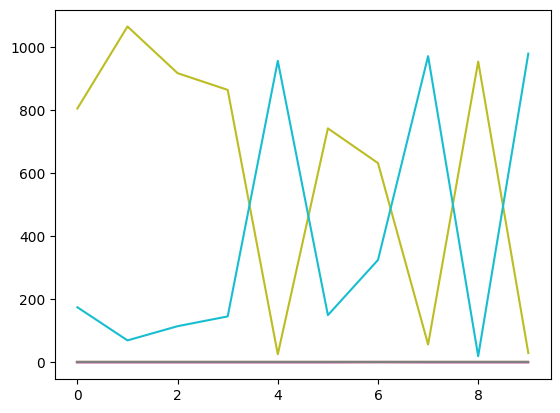

In [ ]:
plt.plot([[   0,    0,    0,    0,    0,    0,    0,    0,  805,  175],
        [   0,    0,    0,    0,    0,    0,    0,    0, 1065,   70],
        [   0,    0,    0,    0,    0,    0,    0,    0,  917,  115],
        [   0,    0,    0,    0,    0,    0,    0,    0,  864,  146],
        [   0,    0,    0,    0,    0,    0,    0,    0,   26,  956],
        [   0,    0,    0,    0,    0,    0,    0,    0,  742,  150],
        [   0,    0,    0,    0,    0,    0,    1,    0,  632,  325],
        [   0,    0,    0,    0,    0,    0,    0,    0,   57,  971],
        [   0,    0,    0,    0,    0,    0,    0,    0,  954,   20],
        [   0,    0,    0,    0,    0,    0,    0,    0,   30,  979]])

In [ ]:

# model
model = SimpleMLP(num_classes=10)

benchmark = SplitMNIST(n_experiences=5, seed = 1, fixed_class_order=list(range(10)))

# Than we can extract the parallel train and test streams
train_stream = benchmark.train_stream
test_stream = benchmark.test_stream

# Prepare for training & testing
optimizer = SGD(model.parameters(), lr=0.001, momentum=0.9)
criterion = CrossEntropyLoss()


# Evaluation metric
interactive_logger = InteractiveLogger()

eval_plugin = EvaluationPlugin(
        accuracy_metrics(minibatch=False, epoch=False, experience=True, stream=True),
        loss_metrics(minibatch=False, epoch=False, experience=True, stream=True),
        timing_metrics(epoch=False, epoch_running=True),
        forgetting_metrics(experience=True, stream=True),
        cpu_usage_metrics(experience=True),
        confusion_matrix_metrics(
            num_classes=10, save_image=True, absolute_class_order= True, stream=True
        ),
        CumulativeAccuracyPluginMetric(),
        CumulativeForgettingPluginMetric(),
        ExperienceMaxGPU(gpu_id=0),
        ExperienceMaxRAM(),
        disk_usage_metrics(minibatch=False, epoch=False, experience=True, stream=True),
        loggers=[TextLogger(open('out.txt', 'w')), interactive_logger]
    )
BATCH_SIZE= 1024

In [ ]:
# Basic loop
for id, experience in enumerate(train_stream):
  print(f"Task {experience.task_label}")
  print(f"Classes in this experience {experience.classes_in_this_experience}")
  dataset = experience.dataset
  print(f"Train data contains {len(dataset)} patterns. With benchmark {train_stream.benchmark}")
  # for x, y, t in dataset:
  #   pass

  test_experience = test_stream[id]
  cumulative_test = test_stream[:id+1]
  print(f"Test data contains {len(test_experience.dataset)}")

Task 0
Classes in this experience [0, 1]
Train data contains 12665 patterns. With benchmark <avalanche.benchmarks.scenarios.deprecated.new_classes.nc_scenario.NCScenario object at 0x7ce64eaee350>
Test data contains 2115
Task 0
Classes in this experience [2, 3]
Train data contains 12089 patterns. With benchmark <avalanche.benchmarks.scenarios.deprecated.new_classes.nc_scenario.NCScenario object at 0x7ce64eaee350>
Test data contains 2042
Task 0
Classes in this experience [4, 5]
Train data contains 11263 patterns. With benchmark <avalanche.benchmarks.scenarios.deprecated.new_classes.nc_scenario.NCScenario object at 0x7ce64eaee350>
Test data contains 1874
Task 0
Classes in this experience [6, 7]
Train data contains 12183 patterns. With benchmark <avalanche.benchmarks.scenarios.deprecated.new_classes.nc_scenario.NCScenario object at 0x7ce64eaee350>
Test data contains 1986
Task 0
Classes in this experience [8, 9]
Train data contains 11800 patterns. With benchmark <avalanche.benchmarks.scenar

# Plotting Functions

In [ ]:

def plot_acc(results, name = '', save = True):
    num_exp = len(results)
    cm_matrix = np.zeros((num_exp,num_exp))
    for i in range(num_exp):
        for j in range(num_exp):
            cm_matrix[i][j] = results[i]['Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp00'+str(j)]

    if save:
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm_matrix, annot=True, cmap='Blues', fmt='g', cbar=False,
                    xticklabels=['Exp 0', 'Exp 1', 'Exp 2', 'Exp 3', 'Exp 4'], yticklabels=['Exp 0', 'Exp 1', 'Exp 2', 'Exp 3', 'Exp 4'])
        plt.xlabel('Testing Experiences')
        plt.ylabel('Training Experiences')
        plt.title('Top Accuracy Matrix')
        plt.savefig(name)
        plt.show()
    return cm_matrix

In [ ]:
def plot_cumulative(results, name):
    num_exp = len(results)
    cm_matrix = np.zeros((num_exp,num_exp))
    for i in range(num_exp):
        for j in range(i+1):
            cm_matrix[i][j] = results[i]['CumulativeAccuracy/eval_phase/test_stream/Exp00'+str(j)]

    cm_labels = []
    for i in range(len(cm_matrix)):
        dum = []
        for j in range(len(cm_matrix)):
            if cm_matrix[i][j] == 0:
                dum.append(-1)
            else:
                dum.append(cm_matrix[i][j])
        cm_labels.append(dum)

    cm_labels = np.array(cm_labels)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm_labels, annot=True, mask= np.triu(cm_matrix, k=1) ,cmap='Blues', cbar=False,
                xticklabels=['Exp 0', 'Exp 1', 'Exp 2', 'Exp 3', 'Exp 4'], yticklabels=['Exp 0', 'Exp 1', 'Exp 2', 'Exp 3', 'Exp 4'])
    plt.xlabel('Testing Experiences')
    plt.ylabel('Training Experiences')
    plt.title('Cumulative Accuracy Matrix')
    plt.savefig(name)
    plt.show()

In [ ]:
def star(results, name, accuracy_matrix):
    num_exp = len(results)
    RAMUsage = 0.0
    CPUUsage = 0.0
    DiskUsage = 0.0
    top1_acc = 0.0
    Run_time = 0.0
    for i in range(num_exp):
        for j in range(num_exp):
            RAMUsage = max(results[i]["MaxRAMUsage_Experience/eval_phase/test_stream/Task000/Exp00"+str(j)], RAMUsage)
            CPUUsage = max(results[i]["CPUUsage_Exp/eval_phase/test_stream/Task000/Exp00"+str(j)], CPUUsage)
            DiskUsage = max(results[i]["DiskUsage_Exp/eval_phase/test_stream/Task000/Exp00"+str(j)], DiskUsage)
            top1_acc = max(results[i]["Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp00"+str(j)], top1_acc)
        Run_time = max(results[i]["RunningTime_Epoch/train_phase/train_stream/Task000"], Run_time)

    RAMUsage /=8000
    RAMUsage = 1 - RAMUsage
    CPUUsage /= 400
    CPUUsage = 1 - CPUUsage
    DiskUsage /=5000
    DiskUsage = 1-DiskUsage
    Run_time *=60
    Run_time = 1-Run_time

    bwt, fwt, top1_acc = calculate_accuracies_from_accuracy_matrix(results, accuracy_matrix)

    labels = ['Free RAM', 'Free CPU', 'Free Disk', 'Accuracy', 'fwT', 'bwT', 'Training Speed']
    values = [RAMUsage, CPUUsage, DiskUsage, top1_acc, fwt, bwt, Run_time]

    # Number of variables we're plotting.
    num_vars = len(labels)

    # Compute angle each bar is centered on:
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

    # Repeat the first value to close the circle
    values += values[:1]
    angles += angles[:1]

    # Plot
    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    ax.fill(angles, values, color='blue', alpha=0.25)
    ax.plot(angles, values, color='blue', linewidth=2)  # Add lines

    # Label each of the axes
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels)

    # Remove radial labels
    ax.set_yticklabels([])

    # Add some titles to each axis
    # for label, angle in zip(labels, angles):
        # ax.text(angle, 10.5, label, horizontalalignment='center', size=12, color='blue')

    # Add a title and a subtitle describing the chart
    plt.title('Model Performance', size=15, color='black', y=1.1)
    plt.savefig(name)
    plt.show()

In [ ]:
def cal_star_atrributes(results, accuracy_matrix):
    num_exp = len(results)
    RAMUsage = 0.0
    CPUUsage = 0.0
    DiskUsage = 0.0
    top1_acc = 0.0
    Run_time = 0.0
    for i in range(num_exp):
        for j in range(num_exp):
            RAMUsage = max(results[i]["MaxRAMUsage_Experience/eval_phase/test_stream/Task000/Exp00"+str(j)], RAMUsage)
            CPUUsage = max(results[i]["CPUUsage_Exp/eval_phase/test_stream/Task000/Exp00"+str(j)], CPUUsage)
            DiskUsage = max(results[i]["DiskUsage_Exp/eval_phase/test_stream/Task000/Exp00"+str(j)], DiskUsage)
            top1_acc = max(results[i]["Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp00"+str(j)], top1_acc)
        Run_time = max(results[i]["RunningTime_Epoch/train_phase/train_stream/Task000"], Run_time)

    RAMUsage /=8000
    RAMUsage = 1 - RAMUsage
    CPUUsage /= 400
    CPUUsage = 1 - CPUUsage
    DiskUsage /=5000
    DiskUsage = 1-DiskUsage
    Run_time *=60
    Run_time = 1-Run_time

    bwt, fwt, top1_acc = calculate_accuracies_from_accuracy_matrix(results, accuracy_matrix)
    return RAMUsage, CPUUsage, DiskUsage, top1_acc, fwt, bwt, Run_time

In [ ]:
def star_all(naive_result, cum_result, gdumb_result, lwf_result, cwr_result, name):
    labels = ['Free RAM', 'Free CPU', 'Free Disk', 'Accuracy', 'fwT', 'bwT', 'Training Speed']

    # Number of variables we're plotting.
    num_vars = len(labels)

    # Compute angle each bar is centered on:
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

    # Repeat the first value to close the circle
    angles += angles[:1]

    # Plot
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))

    for res, label in zip([naive_result, cum_result, gdumb_result, lwf_result, cwr_result], ['Naive', 'Cumulative', 'GDumb', 'LWF', 'CWR']):
        RAMUsage, CPUUsage, DiskUsage, top1_acc, fwt, bwt, Run_time = cal_star_atrributes(res, plot_acc(res, save=False))
        values = [RAMUsage, CPUUsage, DiskUsage, top1_acc, fwt, bwt, Run_time]
        values += values[:1]
        ax.fill(angles, values, alpha=0.25, label=label)
        ax.plot(angles, values, label=label)



    # Label each of the axes
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels)

    # Remove radial labels
    ax.set_yticklabels([])
    plt.legend(loc='upper right')
    # Add some titles to each axis
    # for label, angle in zip(labels, angles):
        # ax.text(angle, 10.5, label, horizontalalignment='center', size=12, color='blue')

    # Add a title and a subtitle describing the chart
    plt.title('Model Performances', size=15, color='black', y=1.1)
    plt.savefig(name)
    plt.show()

In [ ]:
def calculate_accuracies_from_accuracy_matrix(results, accuracy_matrix):
    """
    Calculate the overall backward and forward accuracies from an accuracy matrix.

    Args:
    - accuracy_matrix (np.array): 2D array where each element (i, j) represents the accuracy
      of task i after last being trained on task j.

    Returns:
    - overall_backward_accuracy (float): Mean of accuracies for each task evaluated after all subsequent tasks.
    - overall_forward_accuracy (float): Mean of accuracies for each task evaluated after all previous tasks.
    """
    num_exp = len(results)
    num_tasks = accuracy_matrix.shape[0]

    # Calculate backward accuracy (exclude the first task which has no prior tasks)
    backward_accuracies = np.sum(np.tril(accuracy_matrix, -1)) * 2 / num_exp / (num_exp - 1)  # Take diagonal except the last element
    overall_backward_accuracy = np.mean(backward_accuracies)

    # Calculate forward accuracy (exclude the last task which has no subsequent tasks)
    forward_accuracies = np.sum(np.triu(accuracy_matrix, 1)) * 2 / num_exp / (num_exp - 1)  # Take diagonal except the first element
    overall_forward_accuracy = np.mean(forward_accuracies)
    overall_accuracy = np.mean(np.diag(accuracy_matrix))

    return overall_backward_accuracy, overall_forward_accuracy, overall_accuracy


In [ ]:
def reset_parameters(model):
    for layer in model.children():
        if hasattr(layer, 'reset_parameters'):
            layer.reset_parameters()

# Naive MNIST model

/usr/local/lib/python3.10/dist-packages/avalanche/training/templates/base.py:468: PositionalArgumentsDeprecatedWarning: Avalanche is transitioning to strategy constructors that accept named (keyword) arguments only. This is done to ensure that there is no confusion regarding the meaning of each argument (strategies can have many arguments). Your are passing 3 positional arguments to the Naive.__init__ method. Consider passing them as names arguments. The ability to pass positional arguments will be removed in the future.
  warnings.warn(error_str, category=PositionalArgumentsDeprecatedWarning)




Current Classes:  [0, 1]
-- >> Start of training phase << --
-- >> Start of eval phase << --
-- Starting eval on experience 0 (Task 0) from test stream --
100%|██████████| 3/3 [00:00<00:00,  6.62it/s]
> Eval on experience 0 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 99.3605
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 55555.4102
	Loss_Exp/eval_phase/test_stream/Task000/Exp000 = 2.3247
	MaxGPU0Usage_Experience/eval_phase/test_stream/Task000/Exp000 = 0
	MaxRAMUsage_Experience/eval_phase/test_stream/Task000/Exp000 = 0
	Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp000 = 0.0137


/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef681656350>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 55555.4102
	Loss_Stream/eval_phase/test_stream/Task000 = 2.3247
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0137
100%|██████████| 13/13 [00:01<00:00,  7.57it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0157
-- >> Start of eval phase << --
-- Starting eval on experience 0 (Task 0) from test stream --
100%|██████████| 3/3 [00:00<00:00,  7.25it/s]
> Eval on experience 0 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 99.3608
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 55555.4102
	Loss_Exp/eval_phase/test_stream/Task000/Exp000 = 0.6555
	MaxGPU0Usage_Experience/eval_phase/test_stream/Task000/Exp000 = 1.0000
	MaxRAMUsage_Experience/eval_phase/test_s

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef681001690>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 55571.3467
	Loss_Stream/eval_phase/test_stream/Task000 = 6.9161
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 12/12 [00:01<00:00,  7.19it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0162
-- >> Start of eval phase << --
-- Starting eval on experience 1 (Task 0) from test stream --
100%|██████████| 2/2 [00:00<00:00,  4.93it/s]
> Eval on experience 1 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp001 = 100.1668
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp001 = 55571.3467
	Loss_Exp/eval_phase/test_stream/Task000/Exp001 =

/usr/local/lib/python3.10/dist-packages/avalanche/evaluation/metric_utils.py:77: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef680659660>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.9584
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = -0.2057
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 55579.3213
	Loss_Stream/eval_phase/test_stream/Task000 = 0.1364
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.9584
100%|██████████| 12/12 [00:02<00:00,  5.18it/s]
Epoch 7 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0243
-- >> Start of eval phase << --
-- Starting eval on experience 1 (Task 0) from test stream --
100%|██████████| 2/2 [00:00<00:00,  5.13it/s]
> Eval on experience 1 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp001 = 96.

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef66c4f4a00>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 55635.0078
	Loss_Stream/eval_phase/test_stream/Task000 = 8.4369
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 11/11 [00:01<00:00,  6.79it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0169
-- >> Start of eval phase << --
-- Starting eval on experience 2 (Task 0) from test stream --
100%|██████████| 2/2 [00:00<00:00,  5.30it/s]
> Eval on experience 2 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp002 = 98.2

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef6666949d0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 55682.8652
	Loss_Stream/eval_phase/test_stream/Task000 = 8.7284
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 12/12 [00:01<00:00,  7.18it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0163
-- >> Start of eval phase << --
-- Starting eval on experience 3 (Task 0) from test stream --
100%|██████████| 2/2 [00:00<00:00,  5.11

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef6656ecdc0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 55714.7646
	Loss_Stream/eval_phase/test_stream/Task000 = 9.2112
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 12/12 [00:01<00:00,  7.13it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0151
-- >> Start of

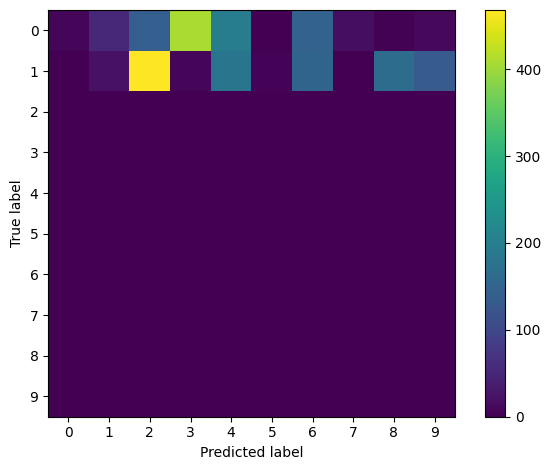

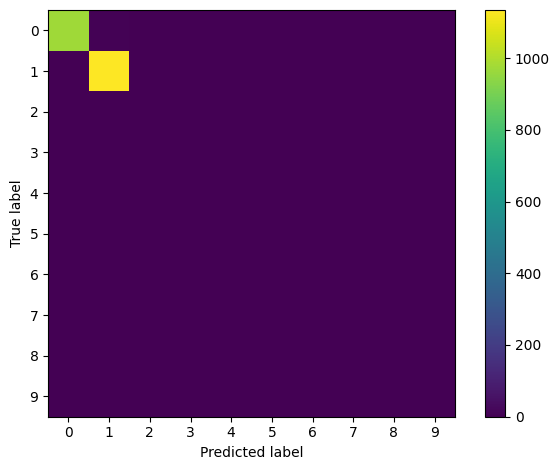

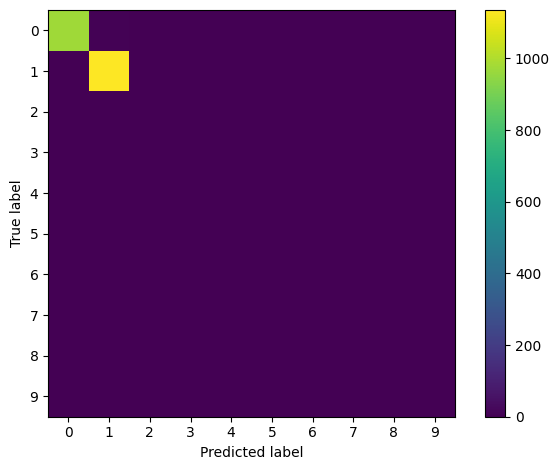

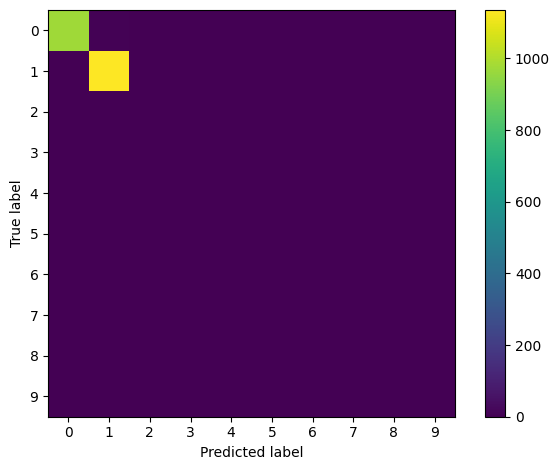

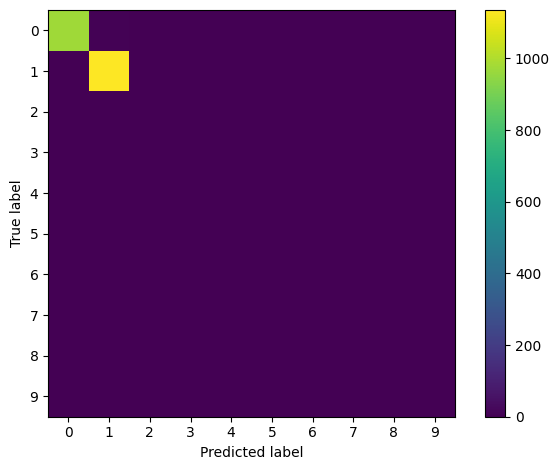

...

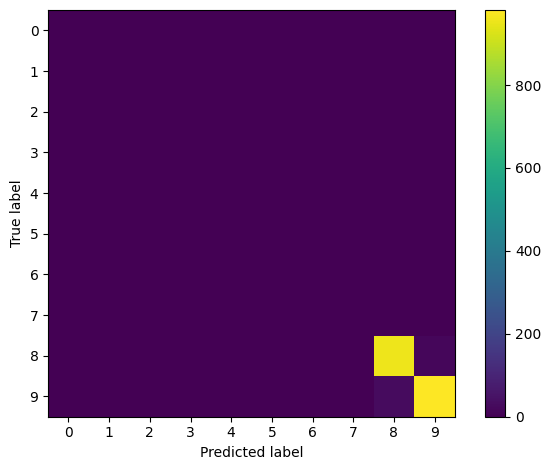

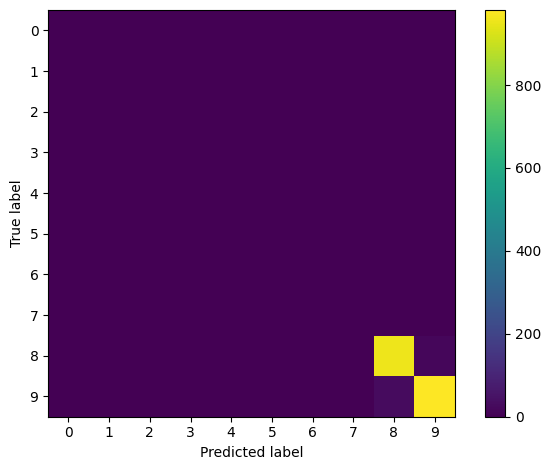

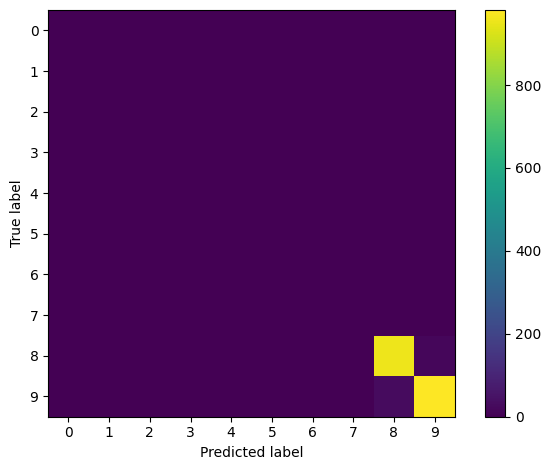

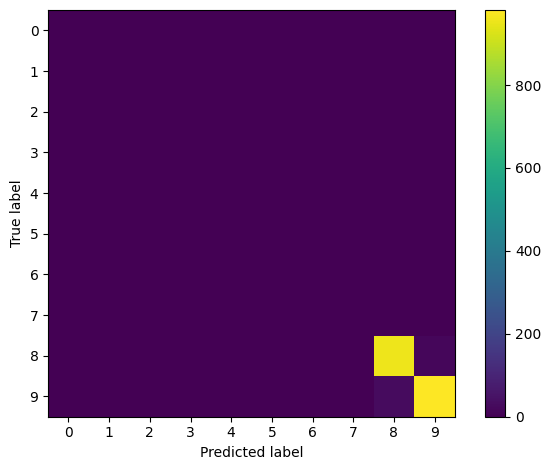

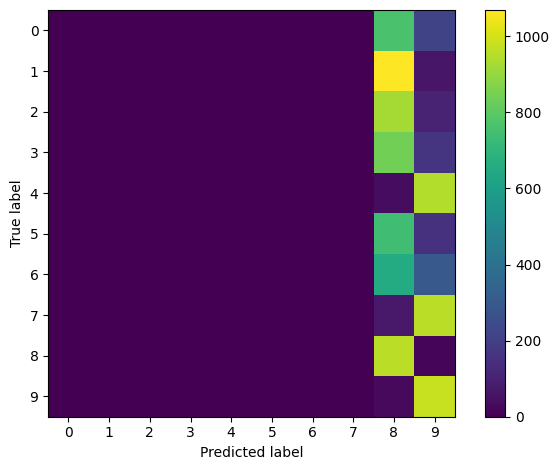

In [ ]:
# Continual learning strategy with default logger
cl_strategy = Naive(
    model,
    optimizer,
    criterion,
    train_mb_size=BATCH_SIZE,
    train_epochs=100,
    eval_mb_size=BATCH_SIZE,
    device=device,
    eval_every=1,
    evaluator = eval_plugin,
    plugins=[EarlyStoppingPlugin(5, "test_stream")],
)

# train and test loop
naive_results = []
for train_task, test_task in zip(train_stream, test_stream):
  print()
  print()
  print("Current Classes: ", train_task.classes_in_this_experience)
  cl_strategy.train(train_task, eval_streams=[test_task])
  naive_results.append(cl_strategy.eval(test_stream))

In [ ]:
np.save('naive_results.npy', naive_results)

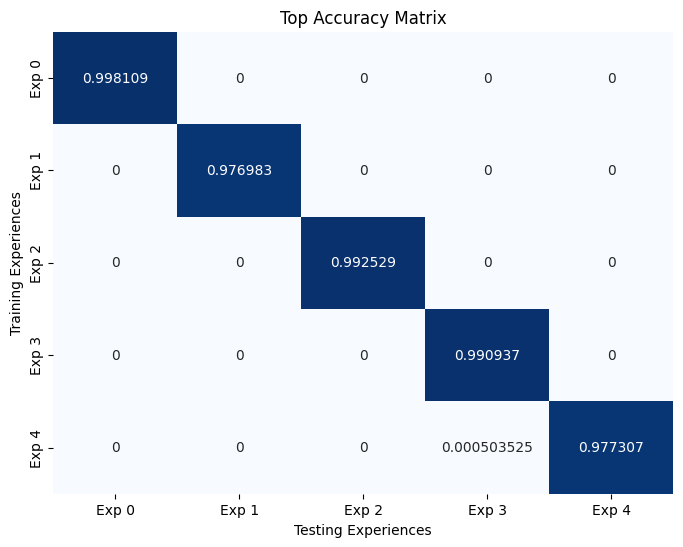

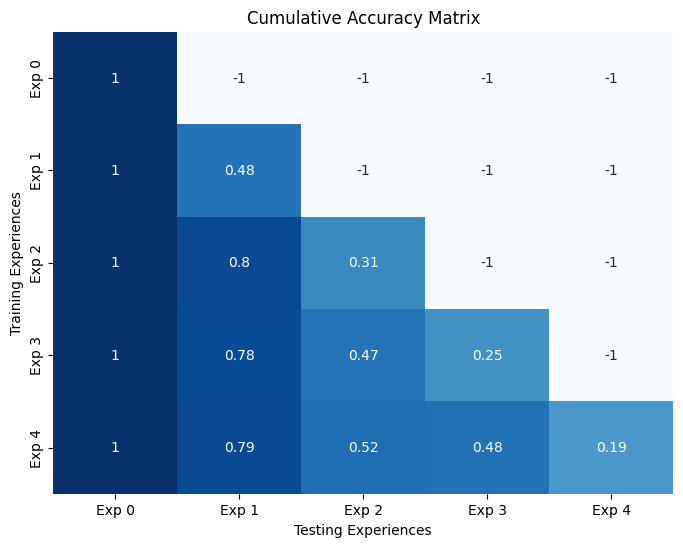

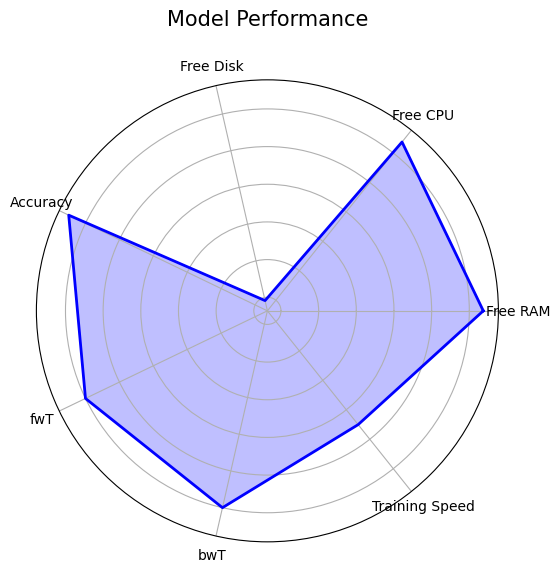

(5.0352467270896274e-05, 0.0, 0.9871730224036419)


In [ ]:
cm = plot_acc(naive_results, "naive_acc.png")
plot_cumulative(naive_results, "naive_cum.png")
star(naive_results, "naive_star.png", cm)
print(calculate_accuracies_from_accuracy_matrix(naive_results, cm))

#Cumulative MNIST model

In [ ]:
from avalanche.training.supervised import Cumulative

/usr/local/lib/python3.10/dist-packages/avalanche/training/templates/base.py:468: PositionalArgumentsDeprecatedWarning: Avalanche is transitioning to strategy constructors that accept named (keyword) arguments only. This is done to ensure that there is no confusion regarding the meaning of each argument (strategies can have many arguments). Your are passing 3 positional arguments to the Cumulative.__init__ method. Consider passing them as names arguments. The ability to pass positional arguments will be removed in the future.
  warnings.warn(error_str, category=PositionalArgumentsDeprecatedWarning)




Current Classes:  [0, 1]
-- >> Start of training phase << --
-- >> Start of eval phase << --
-- Starting eval on experience 0 (Task 0) from test stream --
100%|██████████| 3/3 [00:00<00:00,  7.03it/s]
> Eval on experience 0 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 98.0699
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 57274.1279
	ExperienceForgetting/eval_phase/test_stream/Task000/Exp000 = 0.5541
	Loss_Exp/eval_phase/test_stream/Task000/Exp000 = 2.1146
	MaxGPU0Usage_Experience/eval_phase/test_stream/Task000/Exp000 = 0
	MaxRAMUsage_Experience/eval_phase/test_stream/Task000/Exp000 = 0
	Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp000 = 0.4440


/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef65c696aa0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.5329
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.4875
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.4875
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.4440
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.4440
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.4634
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.2652
	CumulativeForgetting/eval_phase/test_stream/Exp002 = -0.4490
	CumulativeForgetting/eval_phase/test_stream/Exp003 = -0.3715
	CumulativeForgetting/eval_phase/test_stream/Exp004 = -0.4430
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 57274.1279
	Loss_Stream/eval_phase/test_stream/Task000 = 2.1146
	StreamForgetting/eval_phase/test_stream = 0.5541
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.4440
100%|██████████

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef65a9222c0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.0010
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 57290.0283
	Loss_Stream/eval_phase/test_stream/Task000 = 6.0768
	StreamForgetting/eval_phase/test_stream = 0.9770
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 2

/usr/local/lib/python3.10/dist-packages/avalanche/evaluation/metric_utils.py:77: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef659928a00>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.9476
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.9476
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.9476
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.9476
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.9476
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.0486
	CumulativeForgetting/eval_phase/test_stream/Exp001 = -0.1949
	CumulativeForgetting/eval_phase/test_stream/Exp002 = -0.9092
	CumulativeForgetting/eval_phase/test_stream/Exp003 = -0.8751
	CumulativeForgetting/eval_phase/test_stream/Exp004 = -0.9466
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 57305.9980
	Loss_Stream/eval_phase/test_stream/Task000 = 0.1677
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.9476
100%|█████████

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef658882890>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.0010
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 57345.7422
	Loss_Stream/eval_phase/test_stream/Task000 = 7.8846
	StreamForgetting/eval_phase/test_stream = 0.9925
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 3

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef6555c1ff0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.0010
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 57441.4287
	Loss_Stream/eval_phase/test_stream/Task000 = 7.6158
	StreamForgetting/eval_phase/test_stream = 0.9909
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 4

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef6554f6110>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.0010
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 57489.2793
	Loss_Stream/eval_phase/test_stream/Task000 = 7.6038
	StreamForgetting/eval_phase/test_stream = 0.9773
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 5

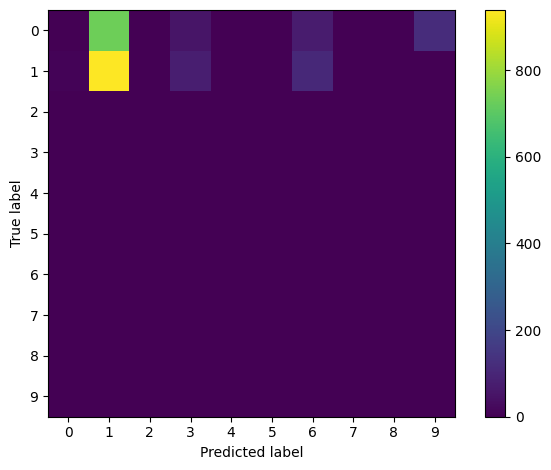

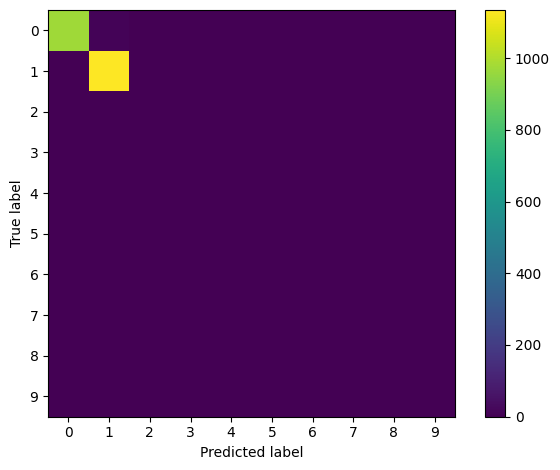

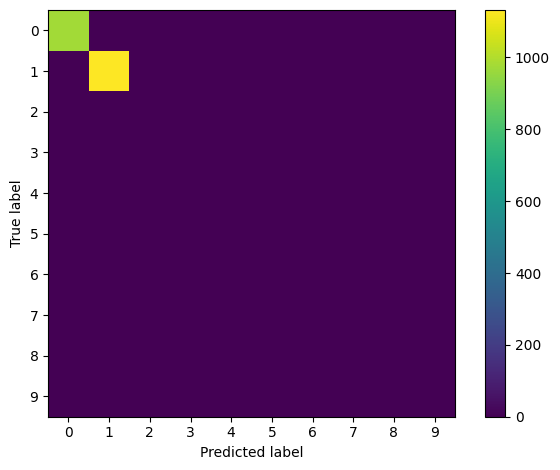

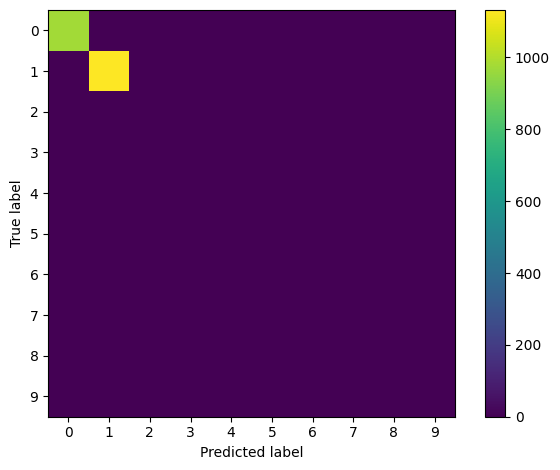

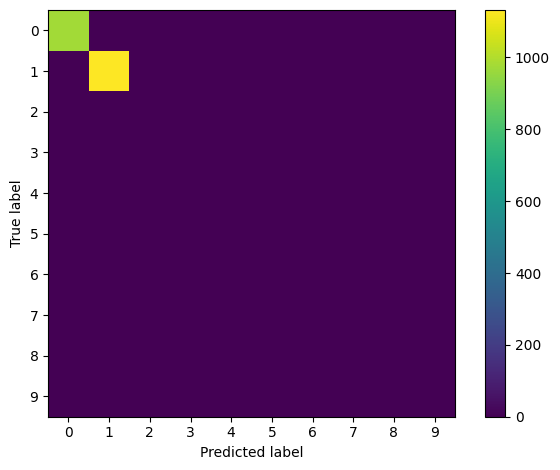

...

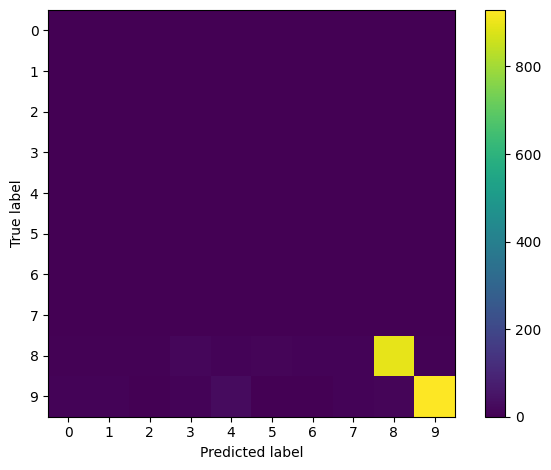

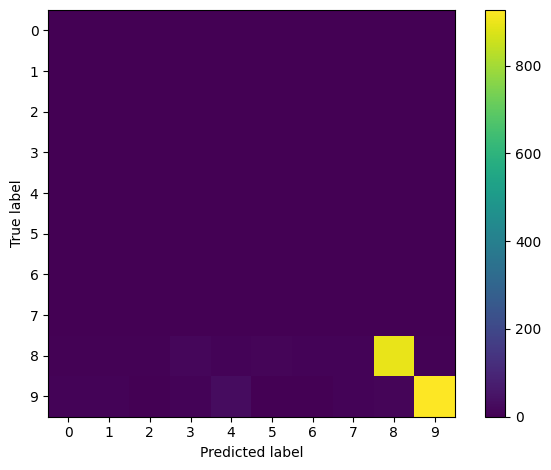

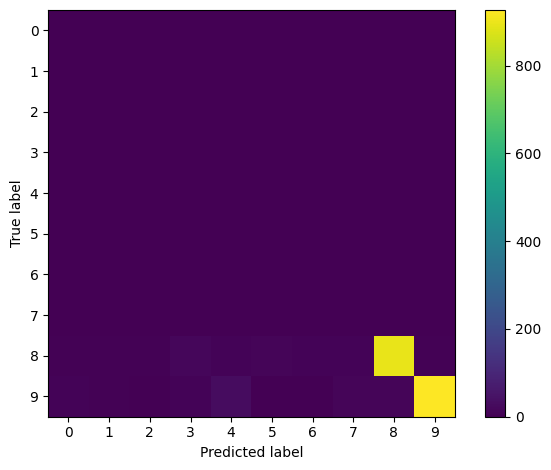

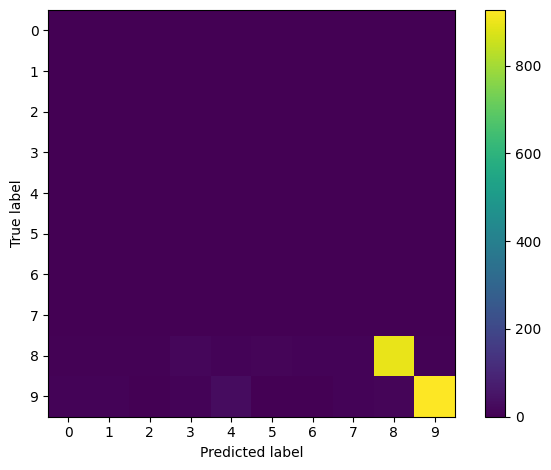

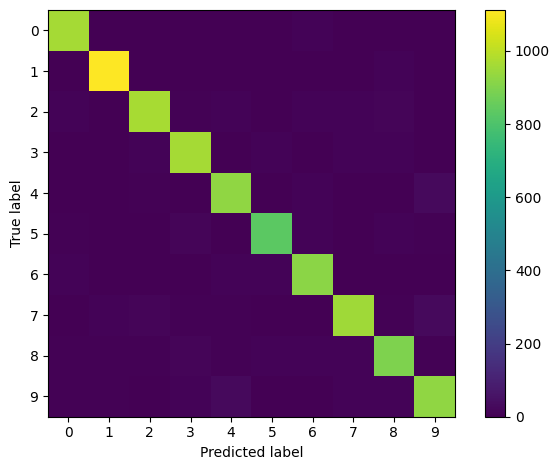

In [ ]:
reset_parameters(model)

optimizer = SGD(model.parameters(), lr=0.001, momentum=0.9)
criterion = CrossEntropyLoss()


# Continual learning strategy with default logger
cl_strategy = Cumulative(
    model,
    optimizer,
    criterion,
    train_mb_size=BATCH_SIZE,
    train_epochs=100,
    eval_mb_size=BATCH_SIZE,
    device=device,
    eval_every=1,
    evaluator = eval_plugin,
    plugins=[EarlyStoppingPlugin(5, "test_stream")],
)

# train and test loop
cumulative_results = []
for train_task, test_task in zip(train_stream, test_stream):
  print()
  print()
  print("Current Classes: ", train_task.classes_in_this_experience)
  cl_strategy.train(train_task, eval_streams=[test_task])
  cumulative_results.append(cl_strategy.eval(test_stream))

In [ ]:
np.save('cumulative_results.npy', cumulative_results)

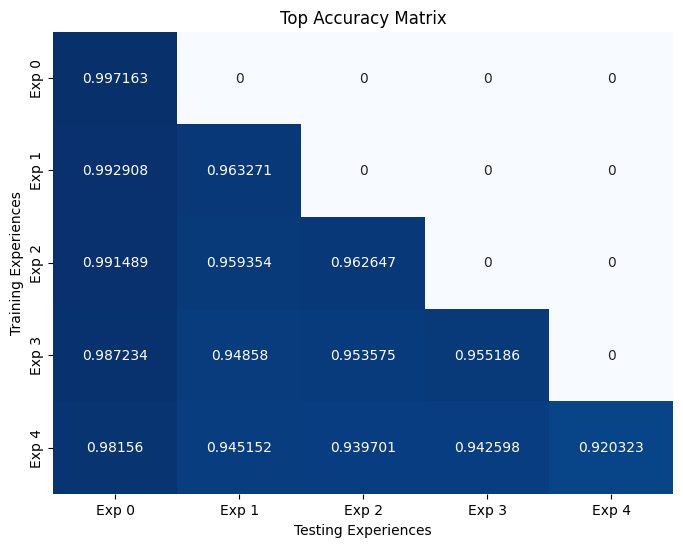

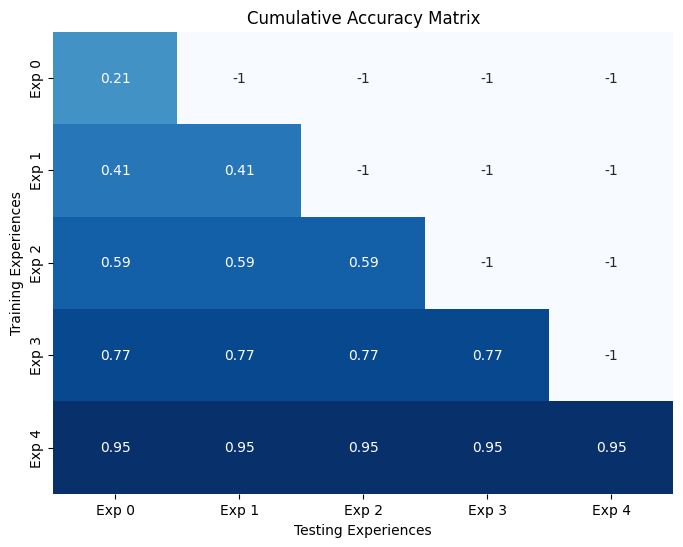

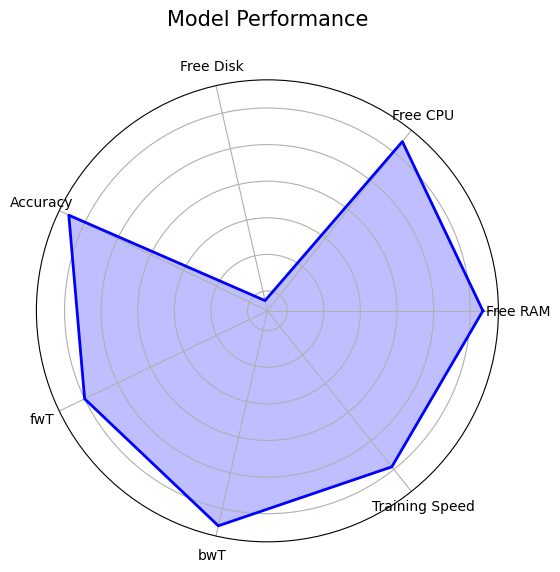

(0.964215130133826, 0.0, 0.9597180431179158)


In [ ]:
cm = plot_acc(cumulative_results, "cum_acc.png")
plot_cumulative(cumulative_results, "cum_cum.png")
star(cumulative_results, "cum_star.png", cm)
print(calculate_accuracies_from_accuracy_matrix(cumulative_results, cm))

# Recall Strategy - GDUMB

In [ ]:
from avalanche.training.plugins import GDumbPlugin

/usr/local/lib/python3.10/dist-packages/avalanche/training/templates/base.py:468: PositionalArgumentsDeprecatedWarning: Avalanche is transitioning to strategy constructors that accept named (keyword) arguments only. This is done to ensure that there is no confusion regarding the meaning of each argument (strategies can have many arguments). Your are passing 3 positional arguments to the Naive.__init__ method. Consider passing them as names arguments. The ability to pass positional arguments will be removed in the future.
  warnings.warn(error_str, category=PositionalArgumentsDeprecatedWarning)




Current Classes:  [0, 1]
-- >> Start of training phase << --
-- >> Start of eval phase << --
-- Starting eval on experience 0 (Task 0) from test stream --
100%|██████████| 3/3 [00:00<00:00,  6.25it/s]
> Eval on experience 0 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 99.7488
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 59018.0215
	ExperienceForgetting/eval_phase/test_stream/Task000/Exp000 = 0.8336
	Loss_Exp/eval_phase/test_stream/Task000/Exp000 = 2.2372
	MaxGPU0Usage_Experience/eval_phase/test_stream/Task000/Exp000 = 0
	MaxRAMUsage_Experience/eval_phase/test_stream/Task000/Exp000 = 2476.6328
	Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp000 = 0.1636


/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef655900d60>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.1636
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.1636
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.1636
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.1636
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.1636
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.8326
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.5891
	CumulativeForgetting/eval_phase/test_stream/Exp002 = -0.1252
	CumulativeForgetting/eval_phase/test_stream/Exp003 = -0.0911
	CumulativeForgetting/eval_phase/test_stream/Exp004 = -0.1626
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 59018.0215
	Loss_Stream/eval_phase/test_stream/Task000 = 2.2372
	StreamForgetting/eval_phase/test_stream = 0.8336
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.1636
100%|██████████

/usr/local/lib/python3.10/dist-packages/avalanche/evaluation/metric_utils.py:77: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef650b2d570>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.0010
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 59049.9141
	Loss_Stream/eval_phase/test_stream/Task000 = 3.1837
	StreamForgetting/eval_phase/test_stream = 0.9633
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 1

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef64def0550>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.0010
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 59137.6602
	Loss_Stream/eval_phase/test_stream/Task000 = 4.3443
	StreamForgetting/eval_phase/test_stream = 0.9626
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 1

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef64aab4dc0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.0010
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 59241.2969
	Loss_Stream/eval_phase/test_stream/Task000 = 4.6542
	StreamForgetting/eval_phase/test_stream = 0.9552
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 1

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ef6476a9bd0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9962
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7527
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0384
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0725
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.0010
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 59345.0488
	Loss_Stream/eval_phase/test_stream/Task000 = 4.7404
	StreamForgetting/eval_phase/test_stream = 0.9203
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 1

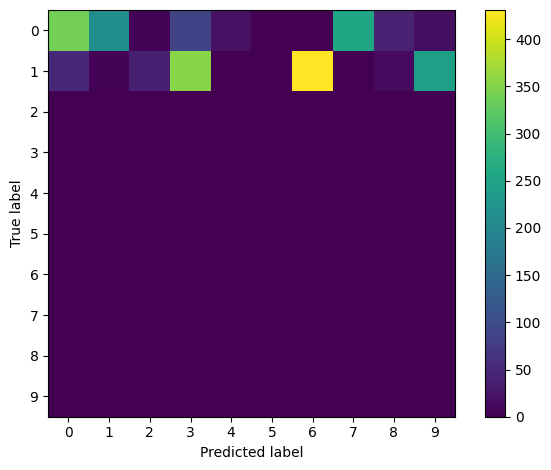

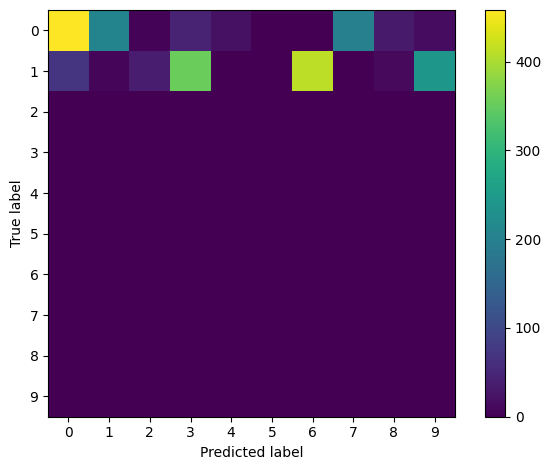

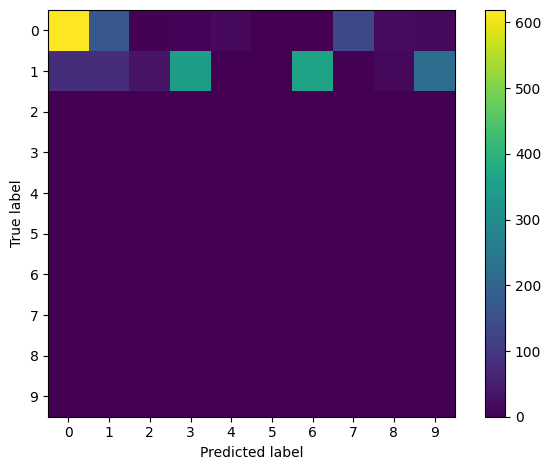

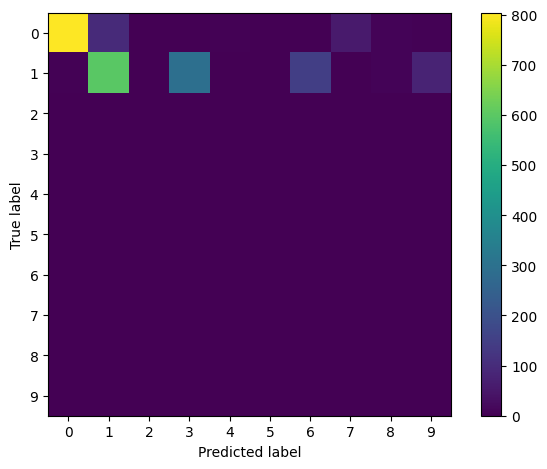

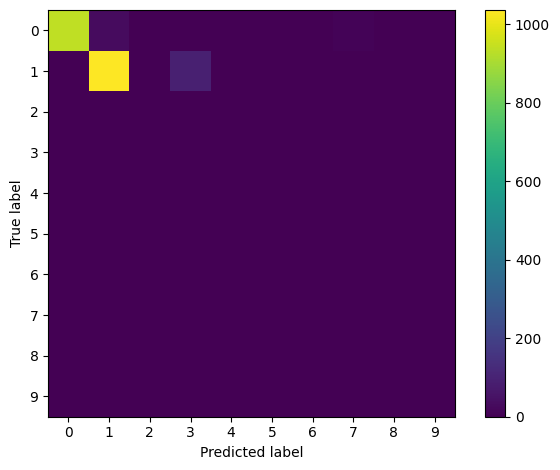

...

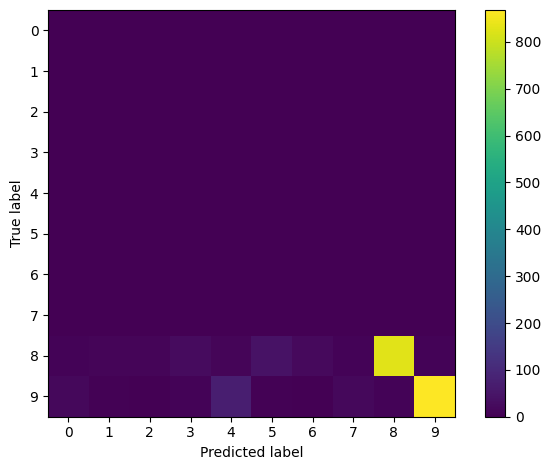

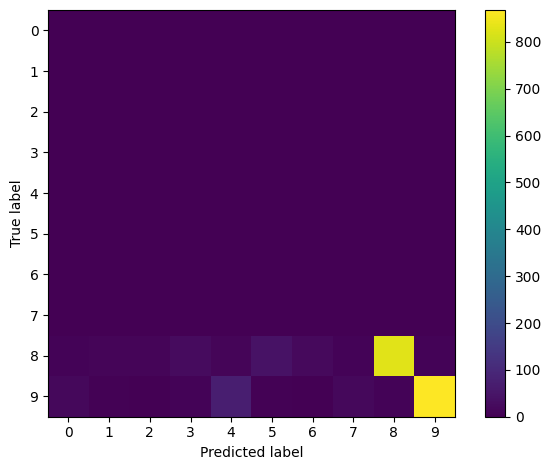

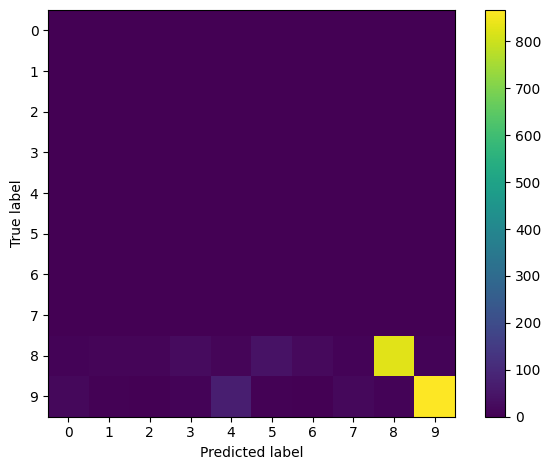

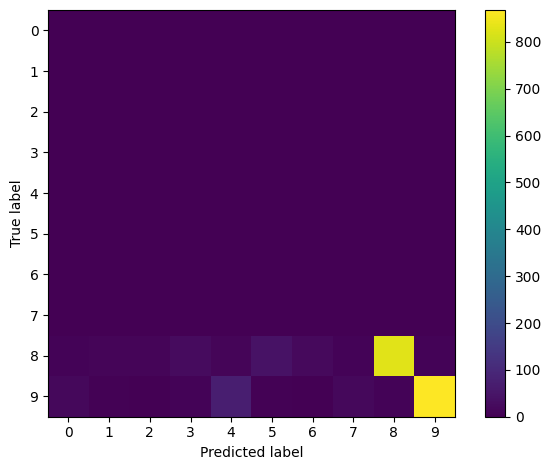

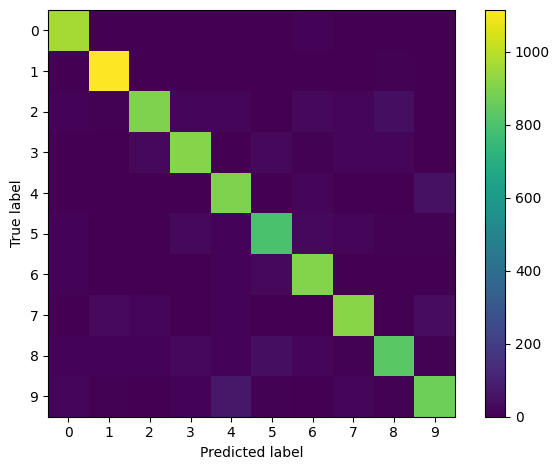

In [ ]:
# Prepare for training & testing
reset_parameters(model)

optimizer = SGD(model.parameters(), lr=0.001, momentum=0.9)
criterion = CrossEntropyLoss()


# Continual learning strategy with default logger
cl_strategy = Naive(
    model,
    optimizer,
    criterion,
    train_mb_size=BATCH_SIZE,
    train_epochs=100,
    eval_mb_size=BATCH_SIZE,
    device=device,
    eval_every=1,
    evaluator = eval_plugin,
    plugins=[EarlyStoppingPlugin(5, "test_stream"), GDumbPlugin(mem_size=500)],
)

# train and test loop
gdumb_results = []
for train_task, test_task in zip(train_stream, test_stream):
  print()
  print()
  print("Current Classes: ", train_task.classes_in_this_experience)
  cl_strategy.train(train_task, eval_streams=[test_task])
  gdumb_results.append(cl_strategy.eval(test_stream))

In [ ]:
np.save('gdumb_results.npy', gdumb_results)

In [ ]:
cm = plot_acc(gdumb_results, "gdumb_acc.png")
plot_cumulative(gdumb_results, "gdumb_cum.png")
star(gdumb_results, "gdumb_star.png", cm)
print(calculate_accuracies_from_accuracy_matrix(gdumb_results, cm))

# Regularization technique - Learning without forgetting (LWF)

In [ ]:
from avalanche.training.plugins import LwFPlugin

/usr/local/lib/python3.10/dist-packages/avalanche/training/templates/base.py:468: PositionalArgumentsDeprecatedWarning: Avalanche is transitioning to strategy constructors that accept named (keyword) arguments only. This is done to ensure that there is no confusion regarding the meaning of each argument (strategies can have many arguments). Your are passing 3 positional arguments to the Naive.__init__ method. Consider passing them as names arguments. The ability to pass positional arguments will be removed in the future.
  warnings.warn(error_str, category=PositionalArgumentsDeprecatedWarning)




Current Classes:  [0, 1]
-- >> Start of training phase << --
-- >> Start of eval phase << --
-- Starting eval on experience 0 (Task 0) from test stream --
100%|██████████| 3/3 [00:00<00:00,  4.54it/s]
> Eval on experience 0 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 91.7950
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 63080.0566
	Loss_Exp/eval_phase/test_stream/Task000/Exp000 = 2.3067
	MaxGPU0Usage_Experience/eval_phase/test_stream/Task000/Exp000 = 3.0000
	MaxRAMUsage_Experience/eval_phase/test_stream/Task000/Exp000 = 0
	Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp000 = 0.0099


/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce646c5dc60>
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63080.0566
	Loss_Stream/eval_phase/test_stream/Task000 = 2.3067
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0099
100%|██████████| 13/13 [00:02<00:00,  5.72it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0457
-- >> Start of eval phase << --
-- Starting eval on experience 0 (Task 0) from test stream --
100%|██████████| 3/3 [00:00<00:00,  6.46it/s]
> Eval on experience 0 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 98.1608
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 63080.0566
	Loss_Exp/eval_phase/test_stream/Task000/Exp000 = 0.5703
	MaxGPU0Usage_Experience/eval_phase/test_stream/Task000/Exp000 = 1.0000
	MaxRAMUsage_Experience/eval_phase/test_s

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce61cb17d00>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63088.0039
	Loss_Stream/eval_phase/test_stream/Task000 = 6.4405
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 12/12 [00:02<00:00,  4.15it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.1126
-- >> Start of eval phase << --
-- Starting eval on experience 1 (Task 0) from test stream --
100%|██████████| 2/2 [00:00<00:00,  4.73it/s]
> Eval on experience 1 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp001 = 98.1939
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp001 = 63088.0039
	Loss_Exp/eval_phase/test_stream/Task000/Exp001 = 

/usr/local/lib/python3.10/dist-packages/avalanche/evaluation/metric_utils.py:77: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce61c372c50>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.9613
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	CumulativeForgetting/eval_phase/test_stream/Exp001 = -0.2258
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63103.9609
	Loss_Stream/eval_phase/test_stream/Task000 = 0.1186
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.9613
100%|██████████| 12/12 [00:01<00:00,  6.95it/s]
Epoch 9 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0166
-- >> Start of eval phase << --
-- Starting eval on experience 1 (Task 0) from test stream --
100%|██████████| 2/2 [00:00<00:00,  4.99it/s]
> Eval on experience 1 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp001 = 100

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce602eaabf0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7356
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63143.8369
	Loss_Stream/eval_phase/test_stream/Task000 = 8.0799
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 11/11 [00:01<00:00,  6.67it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0185
-- >> Start of eval phase << --
-- Starting eval on experience 2 (Task 0) from test stream --
100%|██████████| 2/2 [00:00<00:00,  5.21it/s]
> Eval on experience 2 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp002 = 98.1

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce601a353c0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7356
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0432
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63183.7070
	Loss_Stream/eval_phase/test_stream/Task000 = 9.7719
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 12/12 [00:02<00:00,  5.73it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0165
-- >> Start of eval phase << --
-- Starting eval on experience 3 (Task 0) from test stream --
100%|██████████| 2/2 [00:00<00:00,  3.44

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce5ffaf97e0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7356
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0432
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0559
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63239.5703
	Loss_Stream/eval_phase/test_stream/Task000 = 12.6291
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 12/12 [00:02<00:00,  5.01it/s]
Epoch 0 ended.
	RunningTime_Epoch/train_phase/train_stream/Task000 = 0.0180
-- >> Start o

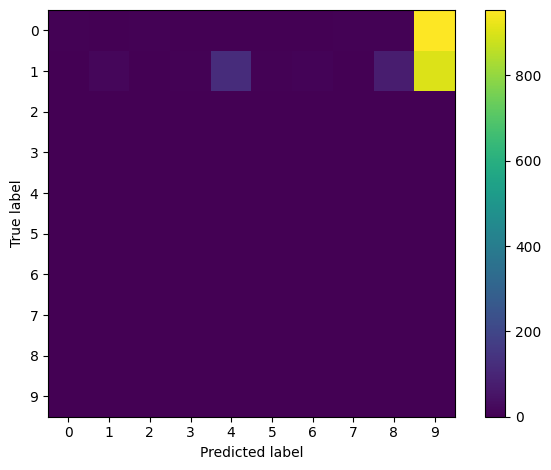

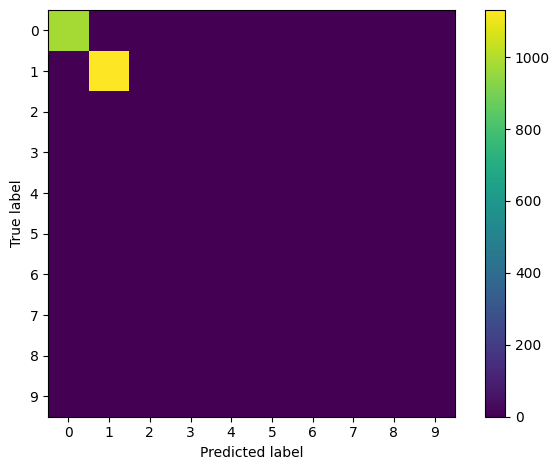

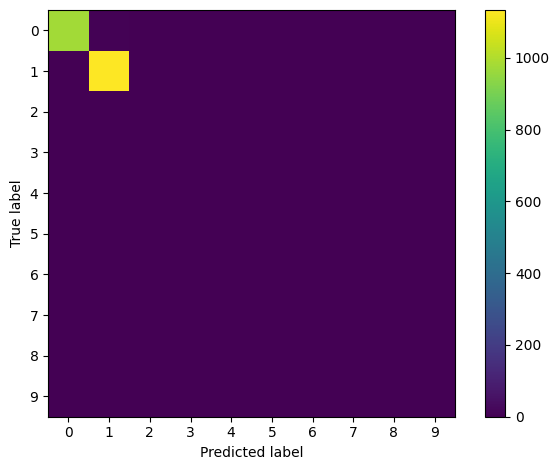

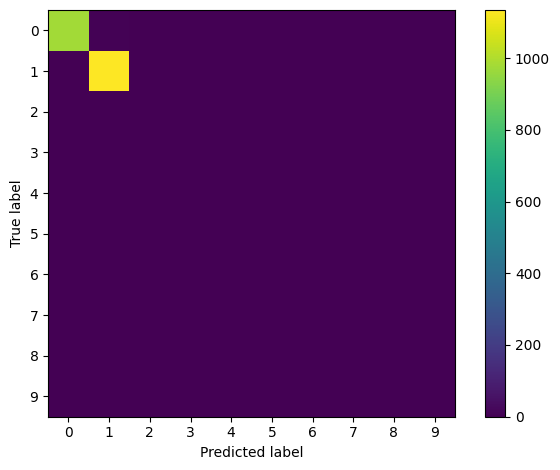

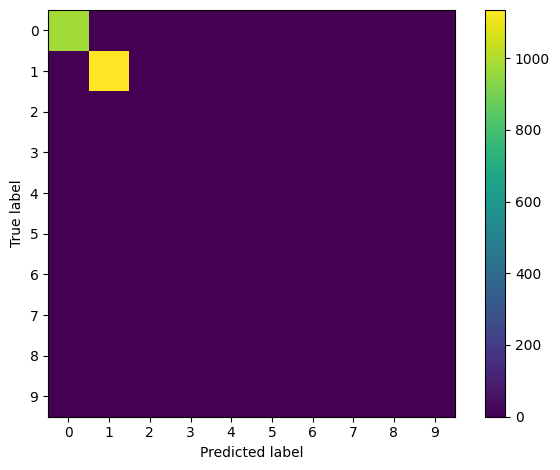

...

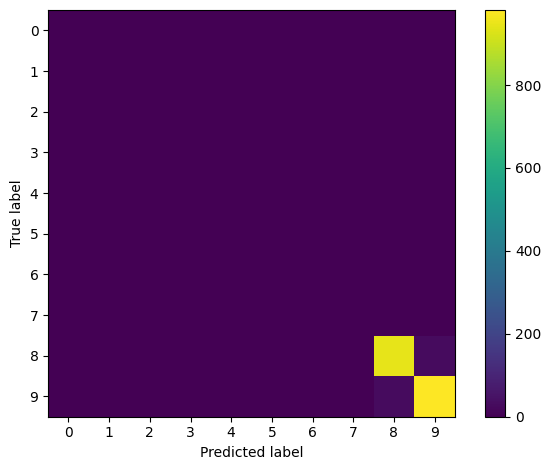

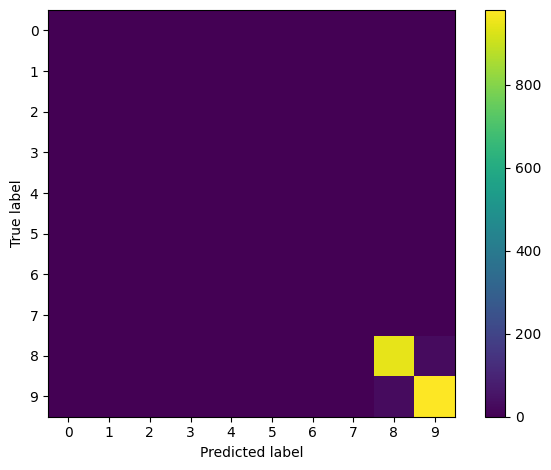

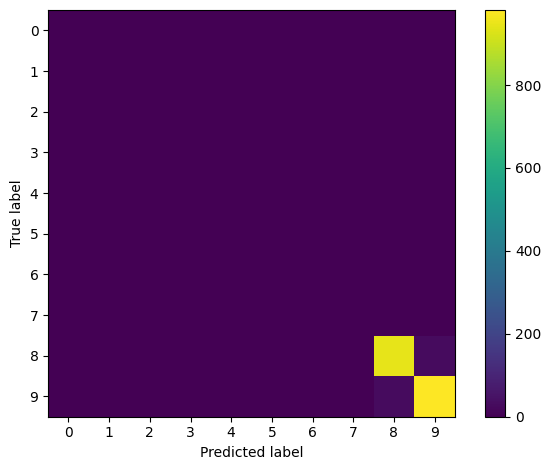

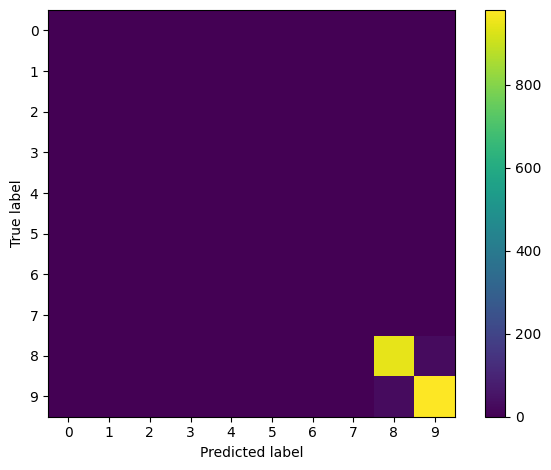

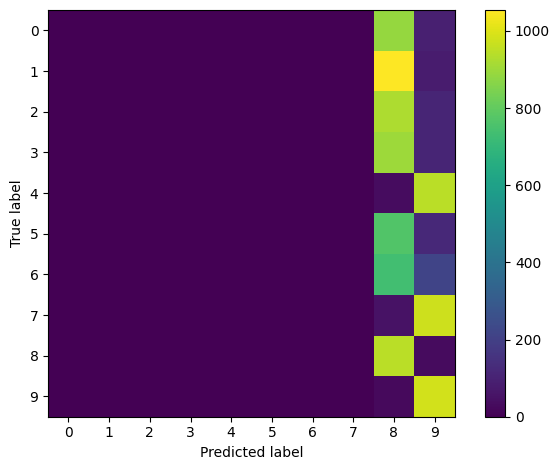

In [ ]:
# Prepare for training & testing
reset_parameters(model)

optimizer = SGD(model.parameters(), lr=0.001, momentum=0.9)
criterion = CrossEntropyLoss()


# Continual learning strategy with default logger
cl_strategy = Naive(
    model,
    optimizer,
    criterion,
    train_mb_size=BATCH_SIZE,
    train_epochs=100,
    eval_mb_size=BATCH_SIZE,
    device=device,
    eval_every=1,
    evaluator = eval_plugin,
    plugins=[EarlyStoppingPlugin(5, "test_stream"), LwFPlugin()],
)

# train and test loop
lwf_results = []
for train_task, test_task in zip(train_stream, test_stream):
  print()
  print()
  print("Current Classes: ", train_task.classes_in_this_experience)
  cl_strategy.train(train_task, eval_streams=[test_task])
  lwf_results.append(cl_strategy.eval(test_stream))

In [ ]:
np.save('lwf_results.npy', lwf_results)

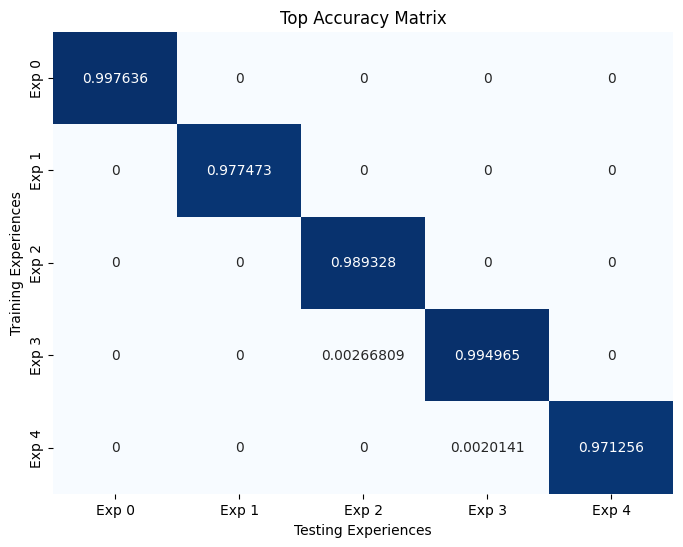

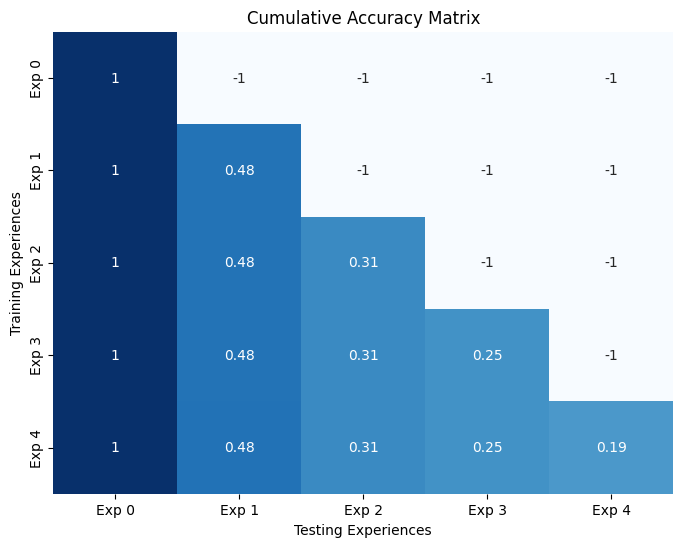

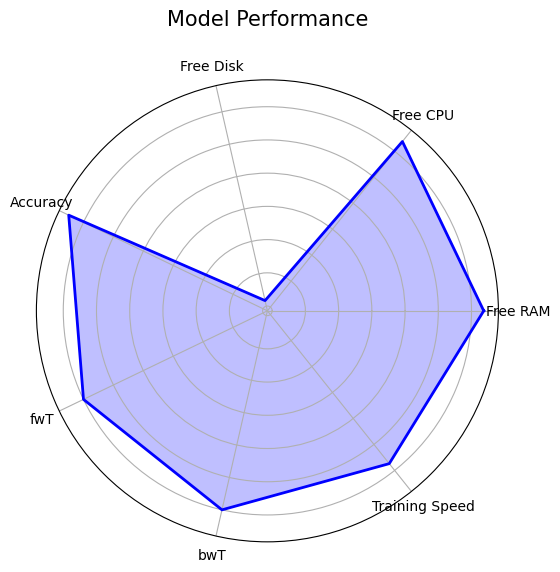

(0.0004682188338648018, 0.0, 0.9861314134664274)


In [ ]:
cm = plot_acc(lwf_results, "lwf_acc.png")
plot_cumulative(lwf_results, "lwf_cum.png")
star(lwf_results, "lwf_star.png", cm)
print(calculate_accuracies_from_accuracy_matrix(lwf_results, cm))

# Architectural Strategies - Copy Weights with Re-Init (CWR)

In [ ]:
from avalanche.training.plugins import CWRStarPlugin

/usr/local/lib/python3.10/dist-packages/avalanche/training/templates/base.py:468: PositionalArgumentsDeprecatedWarning: Avalanche is transitioning to strategy constructors that accept named (keyword) arguments only. This is done to ensure that there is no confusion regarding the meaning of each argument (strategies can have many arguments). Your are passing 3 positional arguments to the Naive.__init__ method. Consider passing them as names arguments. The ability to pass positional arguments will be removed in the future.
  warnings.warn(error_str, category=PositionalArgumentsDeprecatedWarning)




Current Classes:  [0, 1]
-- >> Start of training phase << --
-- >> Start of eval phase << --
-- Starting eval on experience 0 (Task 0) from test stream --
100%|██████████| 3/3 [00:00<00:00,  6.50it/s]
> Eval on experience 0 (Task 0) from test stream ended.
	CPUUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 100.9875
	DiskUsage_Exp/eval_phase/test_stream/Task000/Exp000 = 63417.7998
	ExperienceForgetting/eval_phase/test_stream/Task000/Exp000 = 0.9130
	Loss_Exp/eval_phase/test_stream/Task000/Exp000 = 2.2546
	MaxGPU0Usage_Experience/eval_phase/test_stream/Task000/Exp000 = 0
	MaxRAMUsage_Experience/eval_phase/test_stream/Task000/Exp000 = 2310.0703
	Top1_Acc_Exp/eval_phase/test_stream/Task000/Exp000 = 0.0851


/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce5f7c3fc10>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0851
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0851
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0851
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0851
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0851
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9116
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.6504
	CumulativeForgetting/eval_phase/test_stream/Exp002 = -0.0419
	CumulativeForgetting/eval_phase/test_stream/Exp003 = -0.0292
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.1852
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63417.7998
	Loss_Stream/eval_phase/test_stream/Task000 = 2.2546
	StreamForgetting/eval_phase/test_stream = 0.9130
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0851
100%|██████████|

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce5fddbd0c0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7356
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0432
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0559
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.2703
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63441.7129
	Loss_Stream/eval_phase/test_stream/Task000 = 6.6039
	StreamForgetting/eval_phase/test_stream = 0.9207
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 1

/usr/local/lib/python3.10/dist-packages/avalanche/evaluation/metric_utils.py:77: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce5f6d09db0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.9608
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.9608
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.9608
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.9608
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.9608
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.0359
	CumulativeForgetting/eval_phase/test_stream/Exp001 = -0.2253
	CumulativeForgetting/eval_phase/test_stream/Exp002 = -0.9176
	CumulativeForgetting/eval_phase/test_stream/Exp003 = -0.9049
	CumulativeForgetting/eval_phase/test_stream/Exp004 = -0.6905
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63449.6055
	Loss_Stream/eval_phase/test_stream/Task000 = 0.1435
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.9608
100%|█████████

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce5f5764f70>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7356
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0432
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0559
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.2703
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63497.5469
	Loss_Stream/eval_phase/test_stream/Task000 = 7.7558
	StreamForgetting/eval_phase/test_stream = 0.7231
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 1

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce5f3ed95a0>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7356
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0432
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0559
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.2703
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63545.3516
	Loss_Stream/eval_phase/test_stream/Task000 = 8.7136
	StreamForgetting/eval_phase/test_stream = 0.0000
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 1

/usr/local/lib/python3.10/dist-packages/avalanche/training/plugins/early_stopping.py:114: UserWarning: Metric Top1_Acc_Stream used by the EarlyStopping plugin is not computed yet. EarlyStopping will not be triggered.
  warnings.warn(


-- >> End of eval phase << --
	ConfusionMatrix_Stream/eval_phase/test_stream = <avalanche.evaluation.metric_results.AlternativeValues object at 0x7ce5f3da4d00>
	CumulativeAccuracy/eval_phase/test_stream/Exp000 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp001 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp002 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp003 = 0.0000
	CumulativeAccuracy/eval_phase/test_stream/Exp004 = 0.0000
	CumulativeForgetting/eval_phase/test_stream/Exp000 = 0.9967
	CumulativeForgetting/eval_phase/test_stream/Exp001 = 0.7356
	CumulativeForgetting/eval_phase/test_stream/Exp002 = 0.0432
	CumulativeForgetting/eval_phase/test_stream/Exp003 = 0.0559
	CumulativeForgetting/eval_phase/test_stream/Exp004 = 0.2703
	DiskUsage_Stream/eval_phase/test_stream/Task000 = 63561.2402
	Loss_Stream/eval_phase/test_stream/Task000 = 9.1315
	StreamForgetting/eval_phase/test_stream = 0.4211
	Top1_Acc_Stream/eval_phase/test_stream/Task000 = 0.0000
100%|██████████| 1

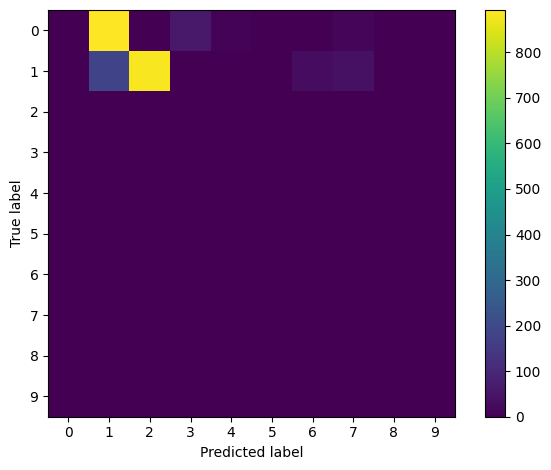

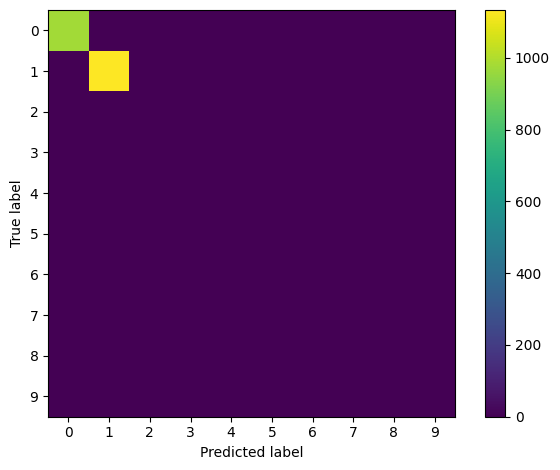

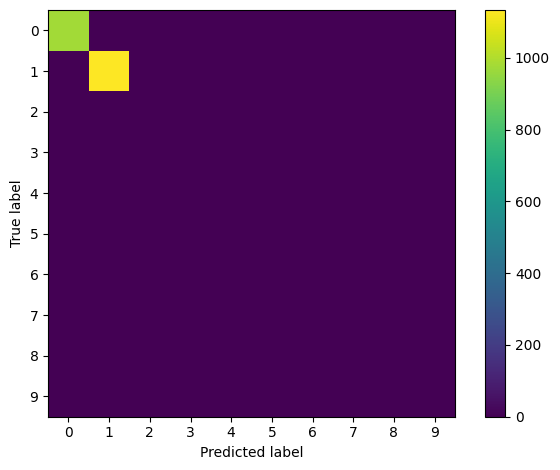

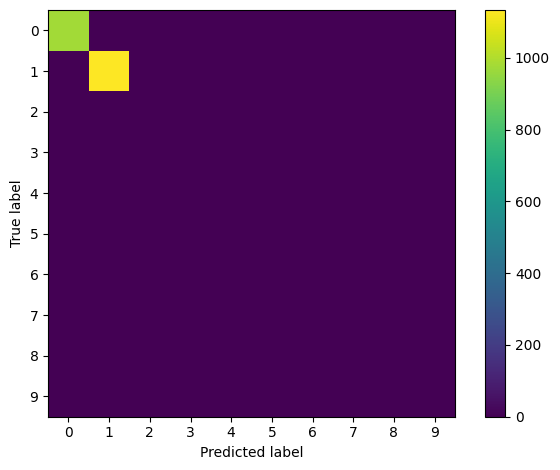

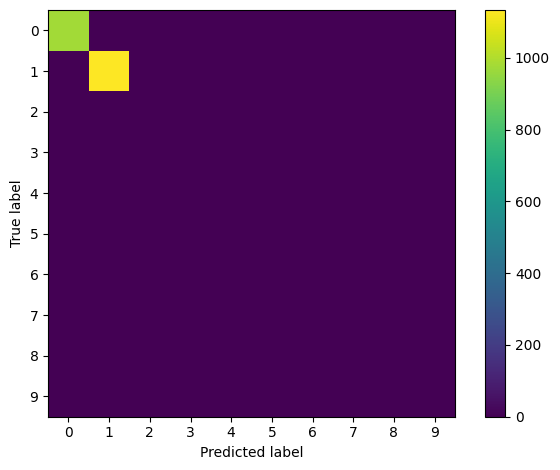

...

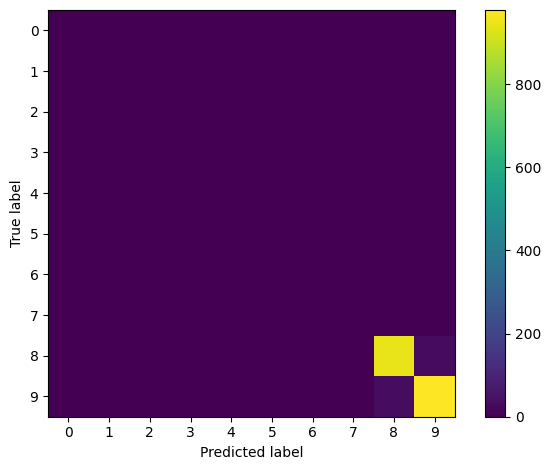

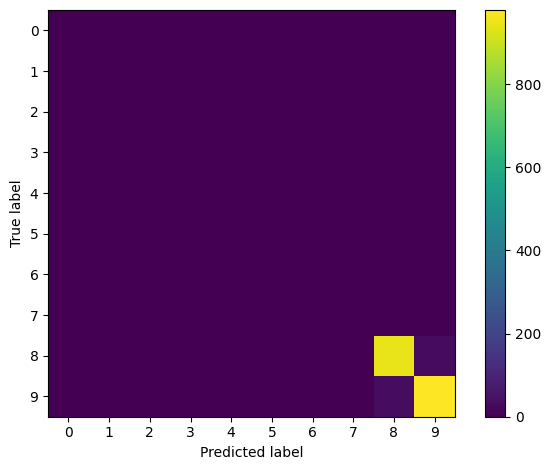

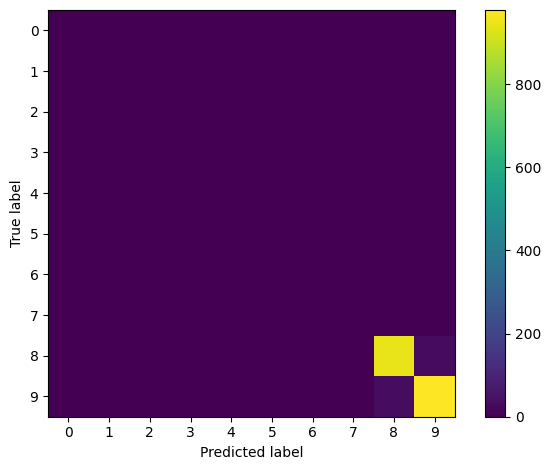

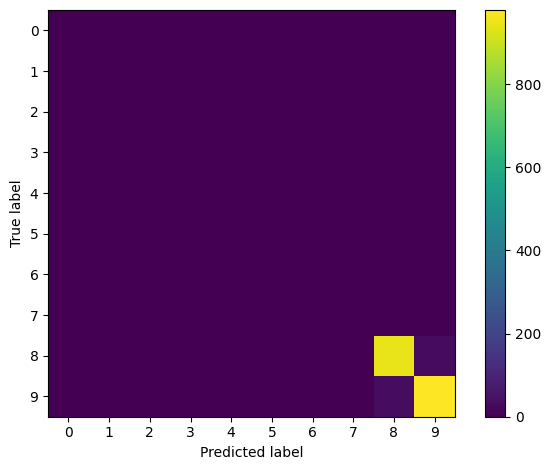

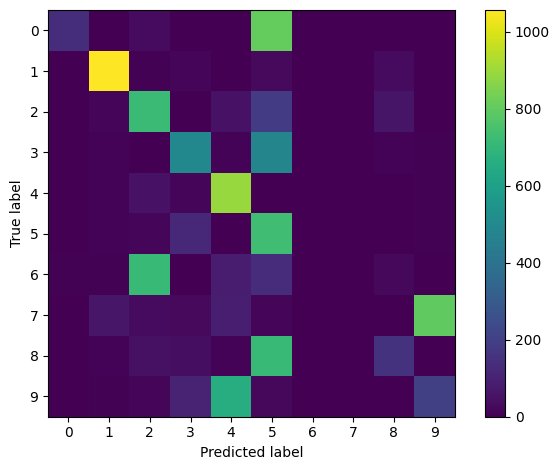

In [ ]:
# Prepare for training & testing
reset_parameters(model)

optimizer = SGD(model.parameters(), lr=0.001, momentum=0.9)
criterion = CrossEntropyLoss()


# Continual learning strategy with default logger
cl_strategy = Naive(
    model,
    optimizer,
    criterion,
    train_mb_size=BATCH_SIZE,
    train_epochs=100,
    eval_mb_size=BATCH_SIZE,
    device=device,
    eval_every=1,
    evaluator = eval_plugin,
    plugins=[EarlyStoppingPlugin(5, "test_stream"), CWRStarPlugin(model)],
)

# train and test loop
cwr_results = []
for train_task, test_task in zip(train_stream, test_stream):
  print()
  print()
  print("Current Classes: ", train_task.classes_in_this_experience)
  cl_strategy.train(train_task, eval_streams=[test_task])
  cwr_results.append(cl_strategy.eval(test_stream))

In [ ]:
np.save('cwr_results.npy', cwr_results)

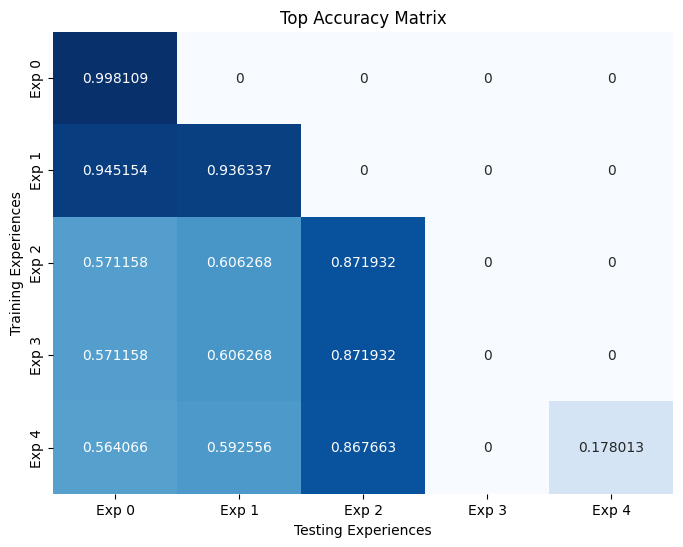

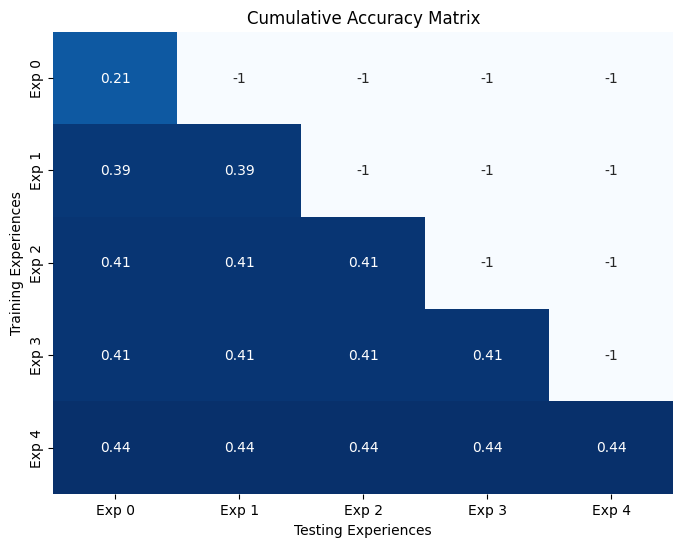

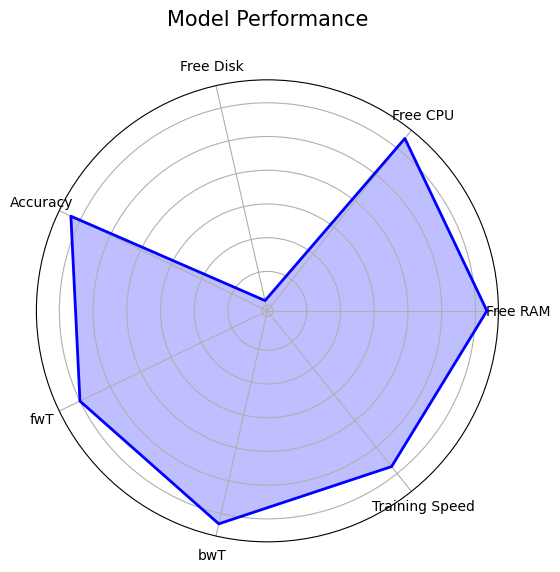

(0.6196224139432838, 0.0, 0.5968780959961953)


In [ ]:
cm = plot_acc(cwr_results, "cwr_acc.png")
plot_cumulative(cwr_results, "cwr_cum.png")
star(cwr_results, "cwr_star.png", cm)
print(calculate_accuracies_from_accuracy_matrix(cwr_results, cm))

In [ ]:
star_all(naive_results, cumulative_results, gdumb_results, lwf_results, cwr_results, "all.png")

NameError: name 'naive_results' is not defined